# Outlier Detection

In [34]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
from sklearn.datasets import fetch_california_housing
from scipy.stats import zscore,iqr

In [35]:
cal = fetch_california_housing()

In [36]:
df = pd.DataFrame(cal.data,columns = cal.feature_names)
df["target"]=cal.target
df

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,target
0,8.3252,41.0,6.984127,1.023810,322.0,2.555556,37.88,-122.23,4.526
1,8.3014,21.0,6.238137,0.971880,2401.0,2.109842,37.86,-122.22,3.585
2,7.2574,52.0,8.288136,1.073446,496.0,2.802260,37.85,-122.24,3.521
3,5.6431,52.0,5.817352,1.073059,558.0,2.547945,37.85,-122.25,3.413
4,3.8462,52.0,6.281853,1.081081,565.0,2.181467,37.85,-122.25,3.422
...,...,...,...,...,...,...,...,...,...
20635,1.5603,25.0,5.045455,1.133333,845.0,2.560606,39.48,-121.09,0.781
20636,2.5568,18.0,6.114035,1.315789,356.0,3.122807,39.49,-121.21,0.771
20637,1.7000,17.0,5.205543,1.120092,1007.0,2.325635,39.43,-121.22,0.923
20638,1.8672,18.0,5.329513,1.171920,741.0,2.123209,39.43,-121.32,0.847


In [37]:
z  = zscore(df) #3 standard deviation
z

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,target
0,2.344766,0.982143,0.628559,-0.153758,-0.974429,-0.049597,1.052548,-1.327835,2.129631
1,2.332238,-0.607019,0.327041,-0.263336,0.861439,-0.092512,1.043185,-1.322844,1.314156
2,1.782699,1.856182,1.155620,-0.049016,-0.820777,-0.025843,1.038503,-1.332827,1.258693
3,0.932968,1.856182,0.156966,-0.049833,-0.766028,-0.050329,1.038503,-1.337818,1.165100
4,-0.012881,1.856182,0.344711,-0.032906,-0.759847,-0.085616,1.038503,-1.337818,1.172900
...,...,...,...,...,...,...,...,...,...
20635,-1.216128,-0.289187,-0.155023,0.077354,-0.512592,-0.049110,1.801647,-0.758826,-1.115804
20636,-0.691593,-0.845393,0.276881,0.462365,-0.944405,0.005021,1.806329,-0.818722,-1.124470
20637,-1.142593,-0.924851,-0.090318,0.049414,-0.369537,-0.071735,1.778237,-0.823713,-0.992746
20638,-1.054583,-0.845393,-0.040211,0.158778,-0.604429,-0.091225,1.778237,-0.873626,-1.058608


In [38]:
cal_df_abs = np.abs(z)
cal_df_abs

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,target
0,2.344766,0.982143,0.628559,0.153758,0.974429,0.049597,1.052548,1.327835,2.129631
1,2.332238,0.607019,0.327041,0.263336,0.861439,0.092512,1.043185,1.322844,1.314156
2,1.782699,1.856182,1.155620,0.049016,0.820777,0.025843,1.038503,1.332827,1.258693
3,0.932968,1.856182,0.156966,0.049833,0.766028,0.050329,1.038503,1.337818,1.165100
4,0.012881,1.856182,0.344711,0.032906,0.759847,0.085616,1.038503,1.337818,1.172900
...,...,...,...,...,...,...,...,...,...
20635,1.216128,0.289187,0.155023,0.077354,0.512592,0.049110,1.801647,0.758826,1.115804
20636,0.691593,0.845393,0.276881,0.462365,0.944405,0.005021,1.806329,0.818722,1.124470
20637,1.142593,0.924851,0.090318,0.049414,0.369537,0.071735,1.778237,0.823713,0.992746
20638,1.054583,0.845393,0.040211,0.158778,0.604429,0.091225,1.778237,0.873626,1.058608


In [39]:
#sns.boxplot(cal_df_abs)

In [76]:
px.box(cal_df_abs) # Can zoom in and out as required

In [43]:
np.where(cal_df_abs>3)

(array([  131,   283,   409,   510,   511,   512,   514,   570,   576,
          710,   780,   799,   864,   865,   867,   869,   871,   922,
          923,   977,   985,   986,   995,  1010,  1021,  1024,  1024,
         1039,  1060,  1086,  1102,  1102,  1233,  1233,  1234,  1234,
         1235,  1235,  1238,  1238,  1239,  1239,  1240,  1240,  1541,
         1560,  1561,  1563,  1564,  1566,  1566,  1574,  1582,  1583,
         1586,  1591,  1593,  1602,  1617,  1621,  1636,  1637,  1642,
         1644,  1645,  1646,  1700,  1867,  1867,  1872,  1872,  1879,
         1889,  1889,  1910,  1910,  1911,  1911,  1912,  1912,  1913,
         1913,  1914,  1914,  1925,  1926,  1926,  1930,  1978,  1978,
         1979,  1979,  2025,  2119,  2213,  2294,  2311,  2392,  2392,
         2395,  2395,  2396,  2396,  2397,  2397,  2398,  2398,  2511,
         2511,  2776,  2826,  2963,  2969,  2975,  2978,  2999,  3004,
         3086,  3086,  3167,  3177,  3258,  3258,  3292,  3334,  3350,
      

In [44]:
cal_df_abs.iloc[283,4]

3.1432481663576786

In [45]:
cal_df_z = cal_df_abs[(cal_df_abs<3).all(axis=1)]
cal_df_z.shape

(19794, 9)

In [46]:
df.shape

(20640, 9)

In [47]:
px.box(cal_df_z)

# IQR

In [48]:
df_iqr=df

In [49]:
q1 = df_iqr.quantile(0.25)
q3 = df_iqr.quantile(0.75)
IQR = q3-q1
IQR

MedInc          2.179850
HouseAge       19.000000
AveRooms        1.611665
AveBedrms       0.093447
Population    938.000000
AveOccup        0.852520
Latitude        3.780000
Longitude       3.790000
target          1.451250
dtype: float64

Define the normal datarange with lower limit as Q1-1.5*IQR and upper limit as Q3+1.5*IQR.

In [50]:
(df_iqr < (q1 - 1.5*IQR)) | (df_iqr > (q3+1.5*IQR))

,MedInc,HouseAge,AveRooms,AveBedrms,Population,AveOccup,Latitude,Longitude,target
0,True,False,False,False,False,False,False,False,False
1,True,False,False,False,False,False,False,False,False
2,False,False,False,False,False,False,False,False,False
3,False,False,False,False,False,False,False,False,False
4,False,False,False,False,False,False,False,False,False
...,...,...,...,...,...,...,...,...,...
20635,False,False,False,False,False,False,False,False,False
20636,False,False,False,True,False,False,False,False,False
20637,False,False,False,False,False,False,False,False,False
20638,False,False,False,False,False,False,False,False,False


In [51]:
cal_df_iqr = df_iqr[~((df_iqr < (q1 - 1.5*IQR)) | (df_iqr > (q3+1.5*IQR))).any(axis=1)]

In [52]:
cal_df_iqr.shape

(16312, 9)

In [53]:
px.box(cal_df_iqr)

# Probability Distributions

In [54]:
from scipy.stats import skew,kurtosis


In [55]:
np.random.seed(10)
skewed_data = np.random.lognormal(0,1,1000)
sd_skew = skew(skewed_data)
sd_kurt = kurtosis(skewed_data)
sd_kurt

15.755891756264468

In [56]:
unskewed = np.log(skewed_data)
unskewed_skew = skew(unskewed)

In [57]:
unskewed_kurt = kurtosis(unskewed)

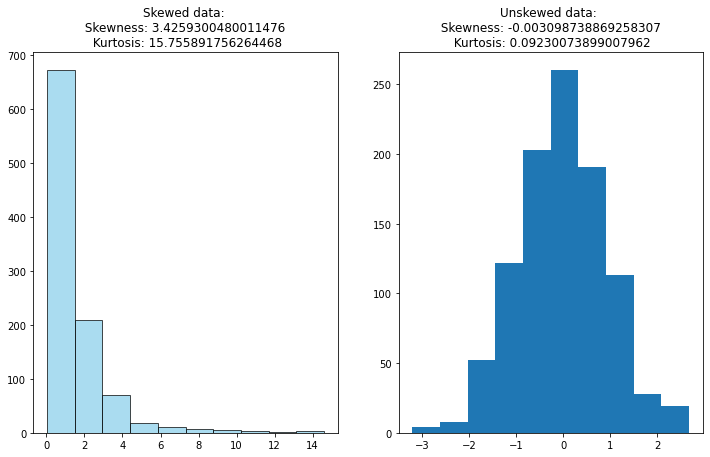

In [75]:
plt.figure(figsize=(12,7))
plt.subplot(1,2,1)
plt.hist(skewed_data,color="skyblue",edgecolor="black",alpha=0.7)
plt.title(f"Skewed data: \n Skewness: {sd_skew} \n Kurtosis: {sd_kurt}")

plt.subplot(1,2,2)
plt.hist(unskewed)
plt.title(f"Unskewed data: \n Skewness: {unskewed_skew} \n Kurtosis: {unskewed_kurt}")
plt.show()

In [59]:
df = pd.read_csv("students.csv")
df

,stud.id,name,gender,age,height,weight,religion,nc.score,semester,major,minor,score1,score2,online.tutorial,graduated,salary
1,833917,"Gonzales, Christina",Female,19,160,64.8,Muslim,1.91,1st,Political Science,Social Sciences,NaN,NaN,0,0,NaN
2,898539,"Lozano, T'Hani",Female,19,172,73.0,Other,1.56,2nd,Social Sciences,Mathematics and Statistics,NaN,NaN,0,0,NaN
3,379678,"Williams, Hanh",Female,22,168,70.6,Protestant,1.24,3rd,Social Sciences,Mathematics and Statistics,45.0,46.0,0,0,NaN
4,807564,"Nem, Denzel",Male,19,183,79.7,Other,1.37,2nd,Environmental Sciences,Mathematics and Statistics,NaN,NaN,0,0,NaN
5,383291,"Powell, Heather",Female,21,175,71.4,Catholic,1.46,1st,Environmental Sciences,Mathematics and Statistics,NaN,NaN,0,0,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8235,818044,"Her, Joshua",Male,22,181,79.1,Protestant,2.91,6th,Environmental Sciences,Social Sciences,73.0,71.0,0,1,36750.087135
8236,560166,"Reid, Jose",Male,23,178,72.6,Catholic,2.03,2nd,Environmental Sciences,Mathematics and Statistics,NaN,NaN,0,0,NaN
8237,380174,"Villa, Raechelle",Female,20,169,67.7,Other,3.72,3rd,Environmental Sciences,Economics and Finance,77.0,75.0,1,0,NaN
8238,540967,"Ngo, Preston",Male,23,195,98.6,Other,2.74,4th,Social Sciences,Political Science,50.0,46.0,1,1,40112.041834


In [60]:
df.shape

(8239, 16)

In [61]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 8239 entries, 1 to 8239
Data columns (total 16 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   stud.id          8239 non-null   int64  
 1   name             8239 non-null   object 
 2   gender           8239 non-null   object 
 3   age              8239 non-null   int64  
 4   height           8239 non-null   int64  
 5   weight           8239 non-null   float64
 6   religion         8239 non-null   object 
 7   nc.score         8239 non-null   float64
 8   semester         8239 non-null   object 
 9   major            8239 non-null   object 
 10  minor            8239 non-null   object 
 11  score1           4892 non-null   float64
 12  score2           4892 non-null   float64
 13  online.tutorial  8239 non-null   int64  
 14  graduated        8239 non-null   int64  
 15  salary           1753 non-null   float64
dtypes: float64(5), int64(5), object(6)
memory usage: 1.1+ MB


In [62]:
df.describe()

,stud.id,age,height,weight,nc.score,score1,score2,online.tutorial,graduated,salary
count,8239.000000,8239.000000,8239.000000,8239.000000,8239.000000,4892.000000,4892.000000,8239.000000,8239.000000,1753.000000
mean,548910.484525,22.541571,171.380750,72.998131,2.166481,68.164963,69.494685,0.386212,0.212769,42522.112364
std,253849.389811,6.065111,11.077529,8.635162,0.811548,14.051762,14.395251,0.486910,0.409290,10333.139906
min,110250.000000,18.000000,135.000000,51.400000,1.000000,30.000000,31.000000,0.000000,0.000000,11444.141653
25%,331222.500000,20.000000,163.000000,66.500000,1.460000,58.000000,59.000000,0.000000,0.000000,35206.541598
50%,545132.000000,21.000000,171.000000,71.800000,2.040000,70.000000,71.000000,0.000000,0.000000,41672.009748
75%,770807.500000,23.000000,180.000000,78.500000,2.780000,78.000000,80.000000,1.000000,0.000000,49372.540906
max,989901.000000,64.000000,206.000000,116.000000,4.000000,97.000000,98.000000,1.000000,1.000000,75596.793441


In [63]:
from statistics import mean,median,mode
mean(df['weight'])

72.9981308411215

In [64]:
np.std(df['weight'])

8.634637630634767

In [65]:
skew(df['weight'])

0.6508854364719628

In [66]:
kurtosis(df['weight'])

0.2921368367627899

(array([  78., 1185., 2458., 2130., 1400.,  676.,  232.,   62.,   14.,
           4.]),
 array([ 51.4 ,  57.86,  64.32,  70.78,  77.24,  83.7 ,  90.16,  96.62,
        103.08, 109.54, 116.  ]),
 <BarContainer object of 10 artists>)

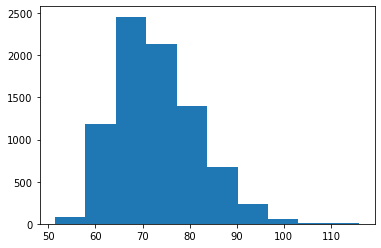

In [67]:
plt.hist(df['weight'])

In [68]:
z = zscore(df['weight'])
z

1      -0.949447
2       0.000216
3      -0.277734
4       0.776161
5      -0.185084
          ...   
8235    0.706673
8236   -0.046109
8237   -0.613590
8238    2.965020
8239   -0.463034
Name: weight, Length: 8239, dtype: float64

(array([  78., 1185., 2458., 2130., 1400.,  676.,  232.,   62.,   14.,
           4.]),
 array([-2.5013361 , -1.75318658, -1.00503706, -0.25688754,  0.49126198,
         1.2394115 ,  1.98756102,  2.73571054,  3.48386006,  4.23200958,
         4.9801591 ]),
 <BarContainer object of 10 artists>)

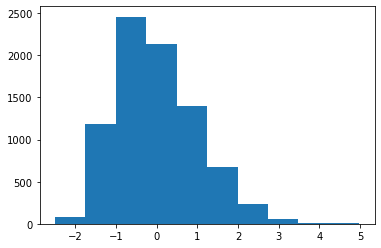

In [69]:
plt.hist(z)